In [1]:
import os
HOME = os.getcwd()
print(HOME)
os.environ["TOKENIZERS_PARALLELISM"] = "false"

/teamspace/studios/this_studio/ODProject


In [2]:
%cd {HOME}
!git clone https://github.com/IDEA-Research/GroundingDINO.git
%cd {HOME}/GroundingDINO
!pip install -q -e .
!pip install -q roboflow


/teamspace/studios/this_studio/ODProject
Cloning into 'GroundingDINO'...


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/IPython/core/magics/osm.py:417: UserWarning: using dhist requires you to install the `pickleshare` library.
  self.shell.db['dhist'] = compress_dhist(dhist)[-100:]



/teamspace/studios/this_studio/ODProject/GroundingDINO


  DEPRECATION: Legacy editable install of groundingdino==0.1.0 from file:///teamspace/studios/this_studio/ODProject/GroundingDINO (setup.py develop) is deprecated. pip 25.1 will enforce this behaviour change. A possible replacement is to add a pyproject.toml or enable --use-pep517, and use setuptools >= 64. If the resulting installation is not behaving as expected, try using --config-settings editable_mode=compat. Please consult the setuptools documentation for more information. Discussion can be found at https://github.com/pypa/pip/issues/11457


In [2]:
import os

CONFIG_PATH = os.path.join(HOME, "GroundingDINO/groundingdino/config/GroundingDINO_SwinT_OGC.py")
print(CONFIG_PATH, "; exist:", os.path.isfile(CONFIG_PATH))


/teamspace/studios/this_studio/ODProject/GroundingDINO/groundingdino/config/GroundingDINO_SwinT_OGC.py ; exist: True


In [4]:
%cd {HOME}
!mkdir {HOME}/weights
%cd {HOME}/weights

!wget -q https://github.com/IDEA-Research/GroundingDINO/releases/download/v0.1.0-alpha/groundingdino_swint_ogc.pth


/teamspace/studios/this_studio/ODProject


/teamspace/studios/this_studio/ODProject/weights


In [3]:
import os

WEIGHTS_NAME = "groundingdino_swint_ogc.pth"
WEIGHTS_PATH = os.path.join(HOME, "weights", WEIGHTS_NAME)
print(WEIGHTS_PATH, "; exist:", os.path.isfile(WEIGHTS_PATH))


/teamspace/studios/this_studio/ODProject/weights/groundingdino_swint_ogc.pth ; exist: True


In [6]:

%cd {HOME}
!mkdir {HOME}/data
%cd {HOME}/data

!wget -q https://media.roboflow.com/notebooks/examples/dog.jpeg
!wget -q https://media.roboflow.com/notebooks/examples/dog-2.jpeg
!wget -q https://media.roboflow.com/notebooks/examples/dog-3.jpeg
!wget -q https://media.roboflow.com/notebooks/examples/dog-4.jpeg


/teamspace/studios/this_studio/ODProject
/teamspace/studios/this_studio/ODProject/data


In [4]:
%cd {HOME}/GroundingDINO

from groundingdino.util.inference import load_model, load_image, predict, annotate

model = load_model(CONFIG_PATH, WEIGHTS_PATH)


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/IPython/core/magics/osm.py:417: UserWarning: using dhist requires you to install the `pickleshare` library.
  self.shell.db['dhist'] = compress_dhist(dhist)[-100:]


/teamspace/studios/this_studio/ODProject/GroundingDINO


final text_encoder_type: bert-base-uncased


# GroundingDino Model Testing over multiple image types

## Basic Markdown
### Objective
- Easily identify basic objects in high resolution images

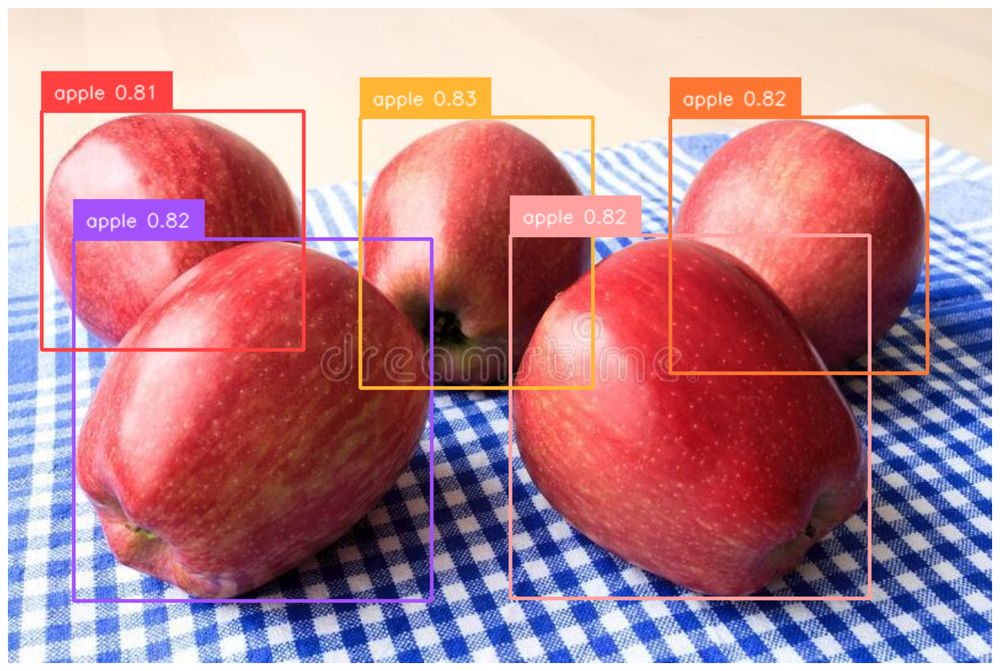

In [5]:
import os
import supervision as sv

IMAGE_NAME = "00004.jpg"
IMAGE_PATH = os.path.join(HOME, "apl/JPEGImages",IMAGE_NAME)

TEXT_PROMPT = "apple"
BOX_TRESHOLD = 0.35
TEXT_TRESHOLD = 0.25

image_source, image = load_image(IMAGE_PATH)

boxes, logits, phrases = predict(
    model=model, 
    image=image, 
    caption=TEXT_PROMPT, 
    box_threshold=BOX_TRESHOLD, 
    text_threshold=TEXT_TRESHOLD
)

annotated_frame = annotate(image_source=image_source, boxes=boxes, logits=logits, phrases=phrases)

%matplotlib inline  
sv.plot_image(annotated_frame, (16, 16))


## Complex Scenes (Multiple Objects, Interactions)
### Objective
- Test performance with cluttered, complex scenes with multiple objects interacting

### Image
- A kitchen with a person cutting vegetables, utensils, fruits, and appliances

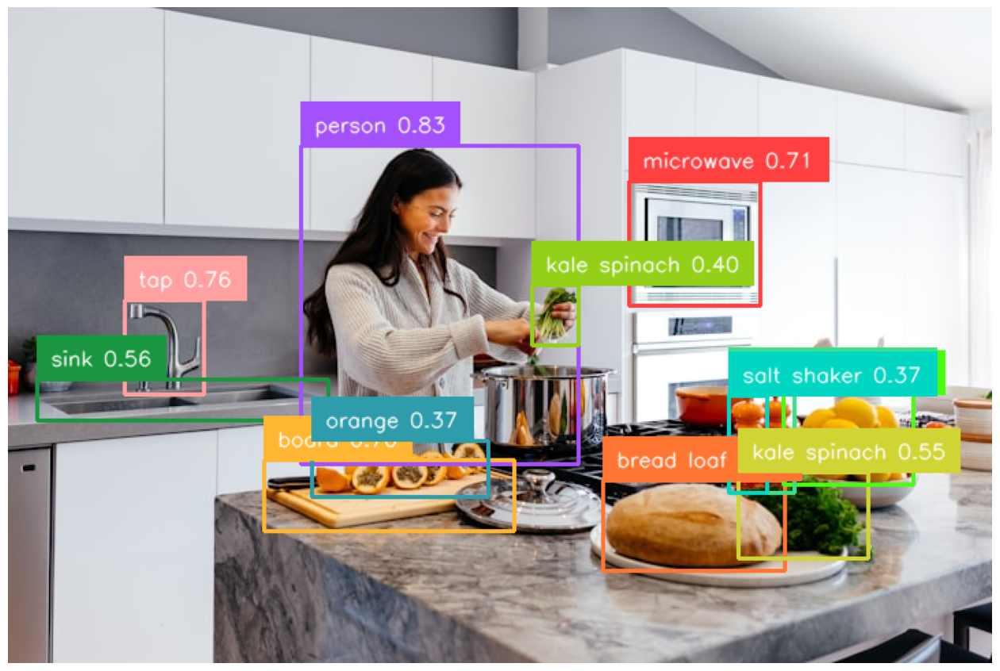

In [6]:
import os
import supervision as sv

IMAGE_NAME = "kitchenscene.jpg"
IMAGE_PATH = os.path.join(HOME, "data",IMAGE_NAME)

TEXT_PROMPT = "person, knife, microwave, cutting board, orange, salt shaker, bread loaf, kale, spinach, laddle, sink, tap"
BOX_TRESHOLD = 0.35
TEXT_TRESHOLD = 0.25

image_source, image = load_image(IMAGE_PATH)

boxes, logits, phrases = predict(
    model=model, 
    image=image, 
    caption=TEXT_PROMPT, 
    box_threshold=BOX_TRESHOLD, 
    text_threshold=TEXT_TRESHOLD
)

annotated_frame = annotate(image_source=image_source, boxes=boxes, logits=logits, phrases=phrases)

%matplotlib inline  
sv.plot_image(annotated_frame, (16, 16))


## Small Object Detection
### Objective
- Testing the ability to locate small or hidden objects in a larger image

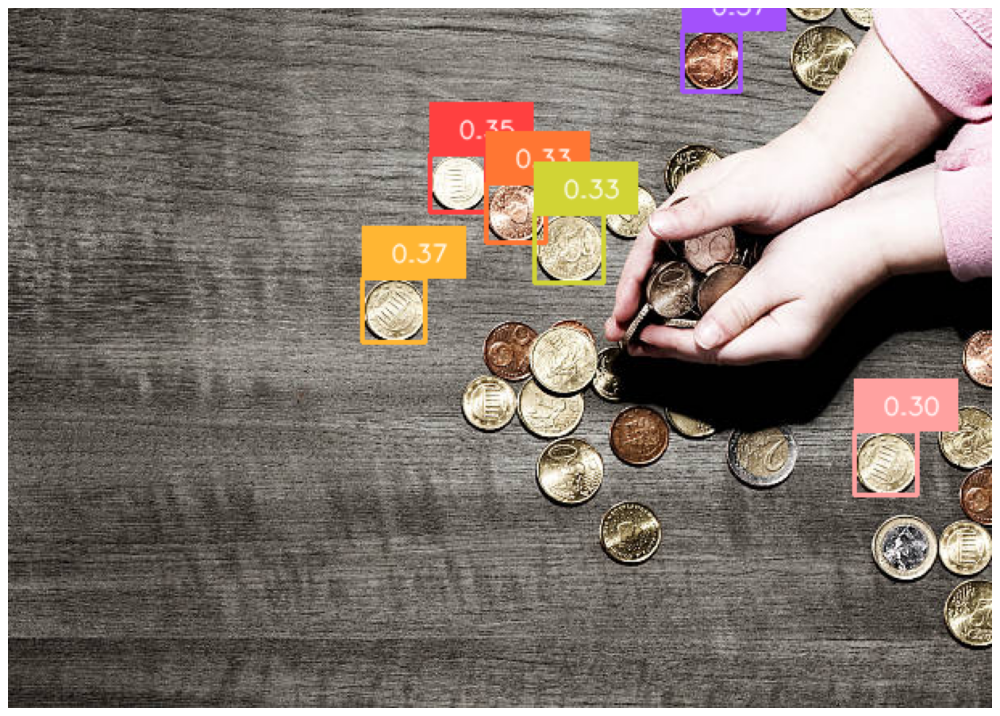

In [7]:
import os
import supervision as sv

IMAGE_NAME = "coins.jpg"
IMAGE_PATH = os.path.join(HOME, "data",IMAGE_NAME)

TEXT_PROMPT = "orange penny"
BOX_TRESHOLD = 0.27
TEXT_TRESHOLD = 0.5

image_source, image = load_image(IMAGE_PATH)

boxes, logits, phrases = predict(
    model=model, 
    image=image, 
    caption=TEXT_PROMPT, 
    box_threshold=BOX_TRESHOLD, 
    text_threshold=TEXT_TRESHOLD
)

annotated_frame = annotate(image_source=image_source, boxes=boxes, logits=logits, phrases=phrases)

%matplotlib inline  
sv.plot_image(annotated_frame, (16, 16))


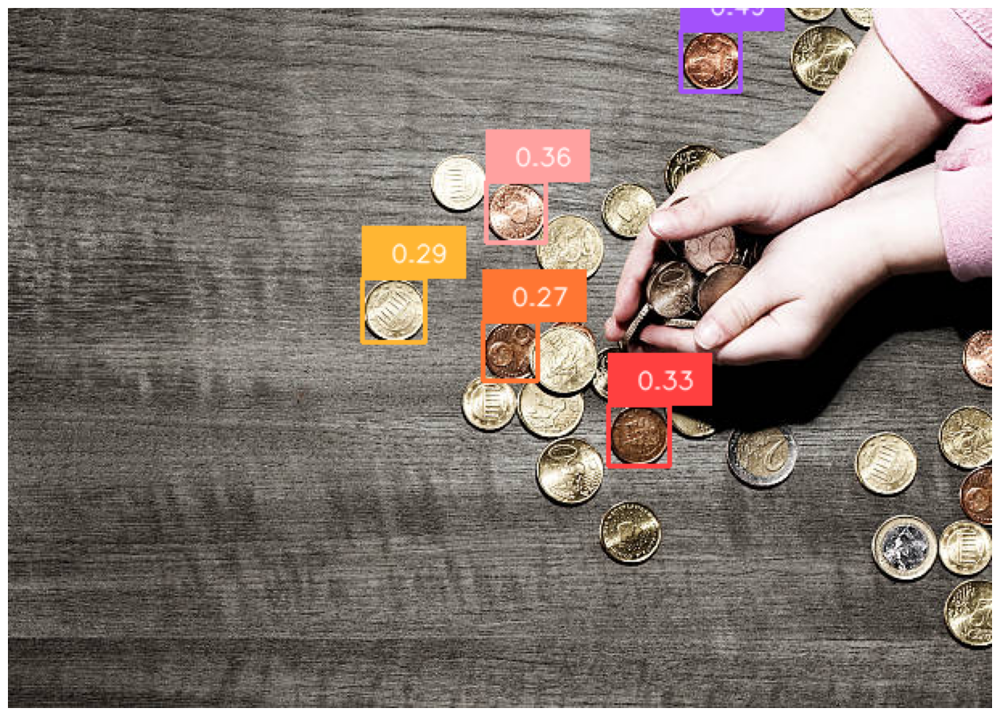

In [8]:
import os
import supervision as sv

IMAGE_NAME = "coins.jpg"
IMAGE_PATH = os.path.join(HOME, "data",IMAGE_NAME)

TEXT_PROMPT = "dark orange penny"
BOX_TRESHOLD = 0.27
TEXT_TRESHOLD = 0.5

image_source, image = load_image(IMAGE_PATH)

boxes, logits, phrases = predict(
    model=model, 
    image=image, 
    caption=TEXT_PROMPT, 
    box_threshold=BOX_TRESHOLD, 
    text_threshold=TEXT_TRESHOLD
)

annotated_frame = annotate(image_source=image_source, boxes=boxes, logits=logits, phrases=phrases)

%matplotlib inline  
sv.plot_image(annotated_frame, (16, 16))

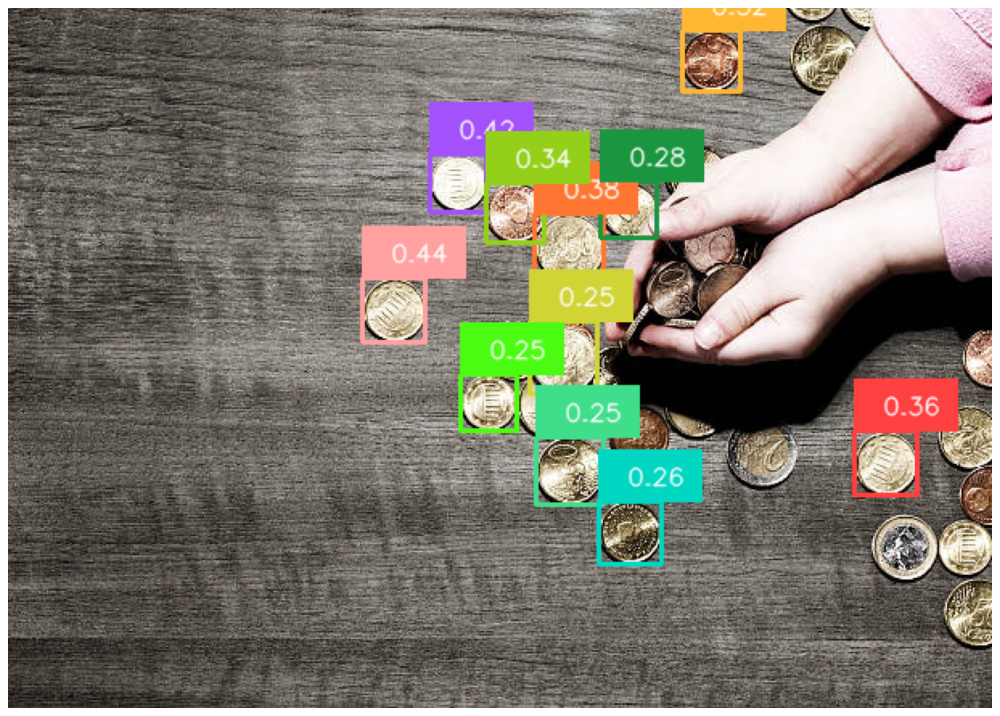

In [9]:
import os
import supervision as sv

IMAGE_NAME = "coins.jpg"
IMAGE_PATH = os.path.join(HOME, "data",IMAGE_NAME)

TEXT_PROMPT = "light orange penny"
BOX_TRESHOLD = 0.25
TEXT_TRESHOLD = 0.5

image_source, image = load_image(IMAGE_PATH)

boxes, logits, phrases = predict(
    model=model, 
    image=image, 
    caption=TEXT_PROMPT, 
    box_threshold=BOX_TRESHOLD, 
    text_threshold=TEXT_TRESHOLD
)

annotated_frame = annotate(image_source=image_source, boxes=boxes, logits=logits, phrases=phrases)

%matplotlib inline  
sv.plot_image(annotated_frame, (16, 16))

## Occlusion and Overlap
### Objective
- Assessing the effect of overlapping objects on finding objects that seem incomplete in images

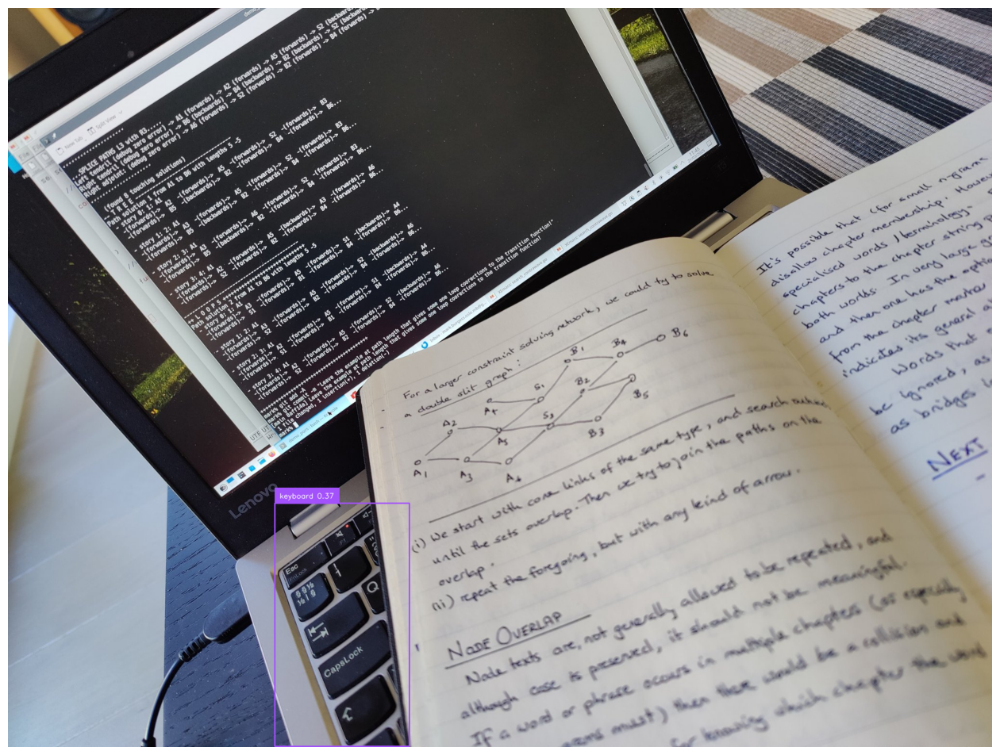

In [10]:
import os
import supervision as sv

IMAGE_NAME = "overlapkeyboard.jpg"
IMAGE_PATH = os.path.join(HOME, "data",IMAGE_NAME)

TEXT_PROMPT = "keyboard"
BOX_TRESHOLD = 0.35
TEXT_TRESHOLD = 0.25

image_source, image = load_image(IMAGE_PATH)

boxes, logits, phrases = predict(
    model=model, 
    image=image, 
    caption=TEXT_PROMPT, 
    box_threshold=BOX_TRESHOLD, 
    text_threshold=TEXT_TRESHOLD
)

annotated_frame = annotate(image_source=image_source, boxes=boxes, logits=logits, phrases=phrases)

%matplotlib inline  
sv.plot_image(annotated_frame, (16, 16))

## Contextual Understanding
### Objective
- Identifying context behind images

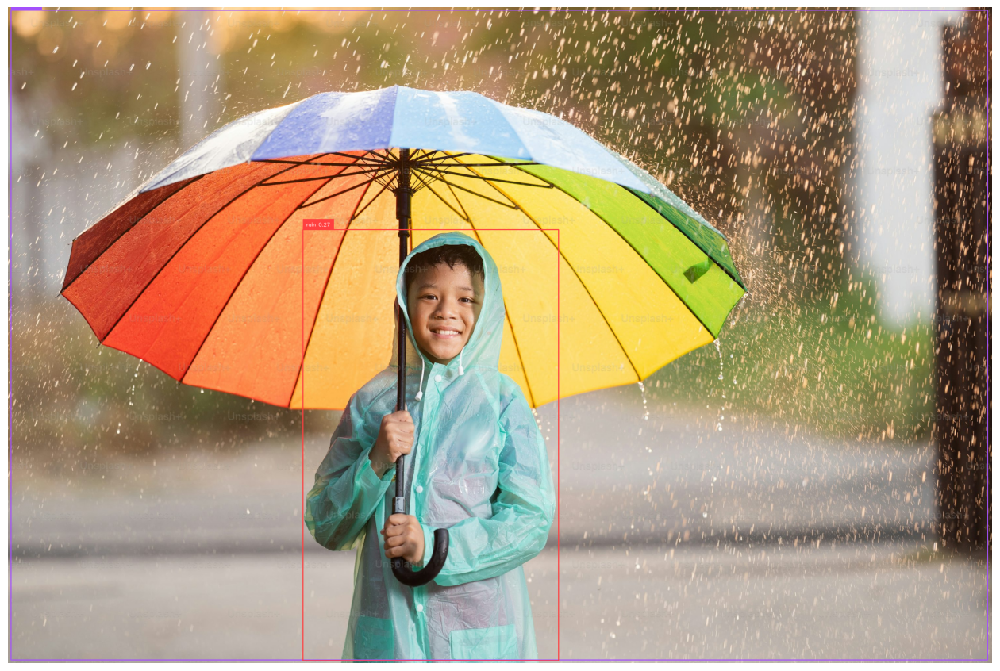

In [11]:
import os
import supervision as sv

IMAGE_NAME = "protectedfromrain.jpg"
IMAGE_PATH = os.path.join(HOME, "data",IMAGE_NAME)

TEXT_PROMPT = "protected from rain"
BOX_TRESHOLD = 0.25
TEXT_TRESHOLD = 0.25

image_source, image = load_image(IMAGE_PATH)

boxes, logits, phrases = predict(
    model=model, 
    image=image, 
    caption=TEXT_PROMPT, 
    box_threshold=BOX_TRESHOLD, 
    text_threshold=TEXT_TRESHOLD
)

annotated_frame = annotate(image_source=image_source, boxes=boxes, logits=logits, phrases=phrases)

%matplotlib inline  
sv.plot_image(annotated_frame, (16, 16))

## Scene and Environment Detection
### Objective
- Identifying environmental features in the background

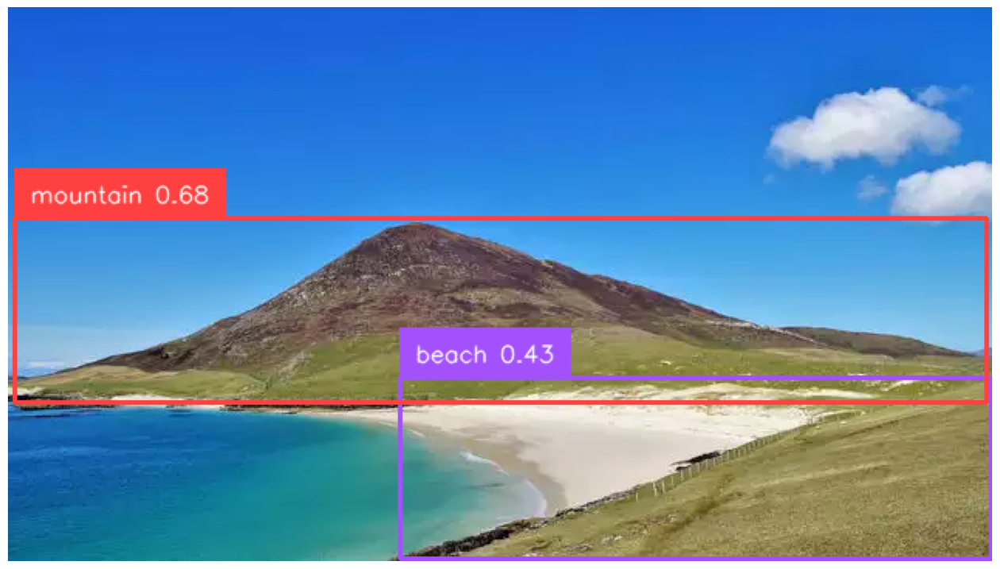

In [12]:
import os
import supervision as sv

IMAGE_NAME = "beachandmountain.webp"
IMAGE_PATH = os.path.join(HOME, "data",IMAGE_NAME)

TEXT_PROMPT = "beach,mountain"
BOX_TRESHOLD = 0.35
TEXT_TRESHOLD = 0.25

image_source, image = load_image(IMAGE_PATH)

boxes, logits, phrases = predict(
    model=model, 
    image=image, 
    caption=TEXT_PROMPT, 
    box_threshold=BOX_TRESHOLD, 
    text_threshold=TEXT_TRESHOLD
)

annotated_frame = annotate(image_source=image_source, boxes=boxes, logits=logits, phrases=phrases)

%matplotlib inline  
sv.plot_image(annotated_frame, (16, 16))

## Rare Objects/Edge Cases
### Objective: 
- Detecting unusual or obscure items


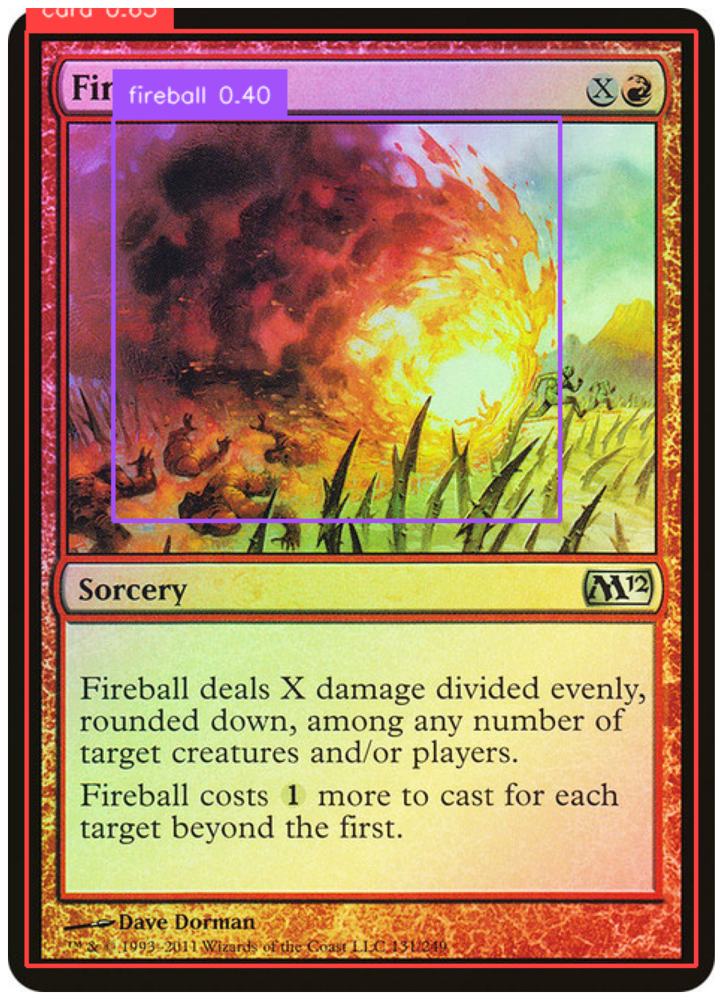

In [13]:
import os
import supervision as sv

IMAGE_NAME = "Fireball_Card.jpg"
IMAGE_PATH = os.path.join(HOME, "data",IMAGE_NAME)

TEXT_PROMPT = "fireball,card"
BOX_TRESHOLD = 0.3
TEXT_TRESHOLD = 0.3

image_source, image = load_image(IMAGE_PATH)

boxes, logits, phrases = predict(
    model=model, 
    image=image, 
    caption=TEXT_PROMPT, 
    box_threshold=BOX_TRESHOLD, 
    text_threshold=TEXT_TRESHOLD
)

annotated_frame = annotate(image_source=image_source, boxes=boxes, logits=logits, phrases=phrases)

%matplotlib inline  
sv.plot_image(annotated_frame, (16, 16))

## Text and Symbol Recognition
### Objective:
- Recognizing printed words or symbols

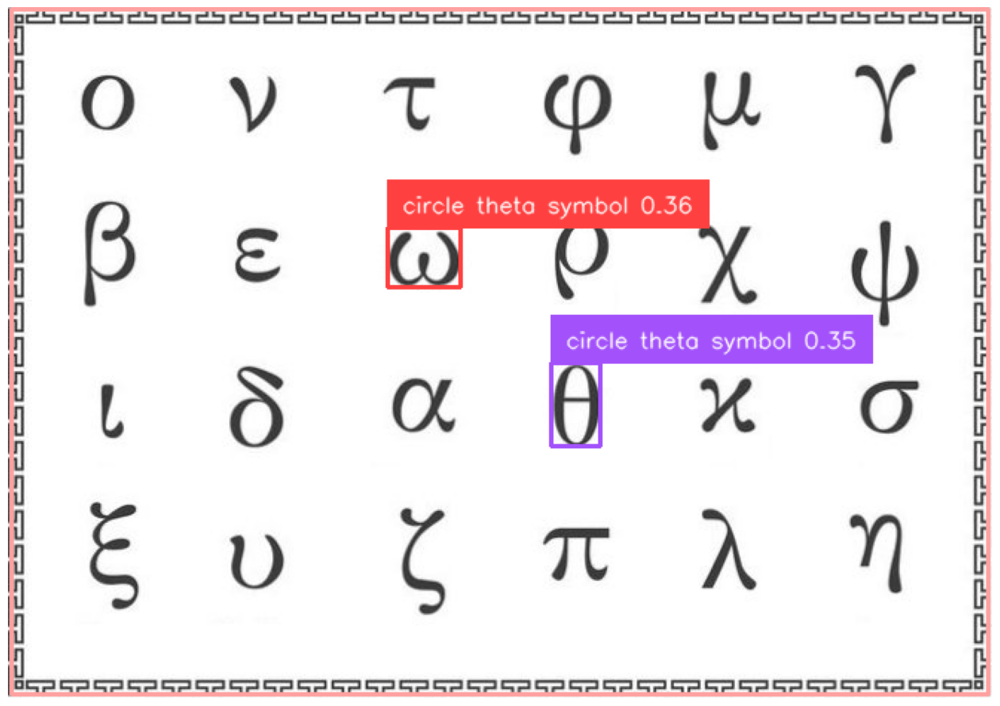

In [14]:
import os
import supervision as sv

IMAGE_NAME = "greek symbols.jpg"
IMAGE_PATH = os.path.join(HOME, "data",IMAGE_NAME)

TEXT_PROMPT = "circle theta symbol"
BOX_TRESHOLD = 0.3
TEXT_TRESHOLD = 0.25

image_source, image = load_image(IMAGE_PATH)

boxes, logits, phrases = predict(
    model=model, 
    image=image, 
    caption=TEXT_PROMPT, 
    box_threshold=BOX_TRESHOLD, 
    text_threshold=TEXT_TRESHOLD
)

annotated_frame = annotate(image_source=image_source, boxes=boxes, logits=logits, phrases=phrases)

%matplotlib inline  
sv.plot_image(annotated_frame, (16, 16))

## Adversarial/Noisy images
### Objective:
- Testing performance on blurry,noisy images

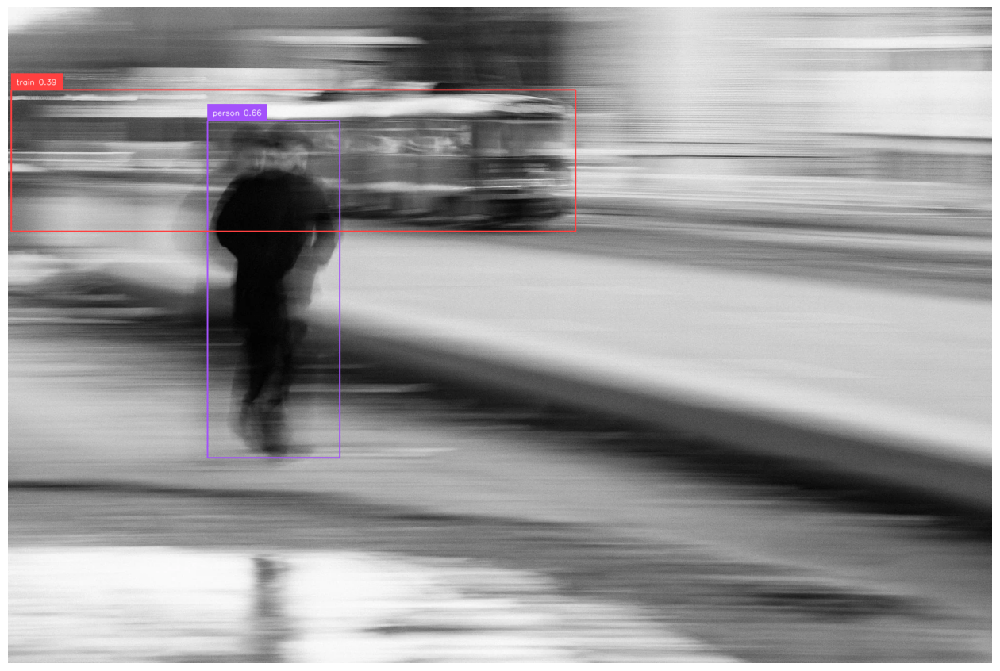

In [15]:
import os
import supervision as sv

IMAGE_NAME = "blurry.webp"
IMAGE_PATH = os.path.join(HOME, "data",IMAGE_NAME)

TEXT_PROMPT = "person,train"
BOX_TRESHOLD = 0.35
TEXT_TRESHOLD = 0.25

image_source, image = load_image(IMAGE_PATH)

boxes, logits, phrases = predict(
    model=model, 
    image=image, 
    caption=TEXT_PROMPT, 
    box_threshold=BOX_TRESHOLD, 
    text_threshold=TEXT_TRESHOLD
)

annotated_frame = annotate(image_source=image_source, boxes=boxes, logits=logits, phrases=phrases)

%matplotlib inline  
sv.plot_image(annotated_frame, (16, 16))

# YOLO-WORLD

In [16]:
import cv2
import supervision as sv

from tqdm import tqdm
from inference.models.yolo_world.yolo_world import YOLOWorld

[03/23/25 04:53:33] WARNING  Your inference package version 0.9.12rc1 is out of date! Please upgrade ]8;id=797895;file:///home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/inference/core/__init__.py\__init__.py]8;;\:]8;id=158344;file:///home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/inference/core/__init__.py#35\35]8;;\
                             to version 0.43.0 of inference for the latest features and bug fixes by               
                             running `pip install --upgrade inference`.                                            

## Basic Markdown
### Objective
- Easily identify basic objects in high resolution images

In [17]:
IMAGE_NAME = "00004.jpg"
IMAGE_PATH = os.path.join(HOME, "apl","JPEGImages",IMAGE_NAME)
SOURCE_IMAGE_PATH: str = IMAGE_PATH
SOURCE_IMAGE_PATH


'/teamspace/studios/this_studio/ODProject/apl/JPEGImages/00004.jpg'

In [18]:
model_yl = YOLOWorld(model_id="yolo_world/l")

In [19]:
classes = ["apple"]
#model_yl.set_classes(classes)

In [20]:
import cv2
import numpy as np

image = cv2.imread(filename=SOURCE_IMAGE_PATH)
if image is None or not isinstance(image, np.ndarray):
    print("Error: Image not loaded properly.")
else:
    print(f"Image shape: {image.shape}")

Image shape: (533, 800, 3)


SupervisionWarnings: BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


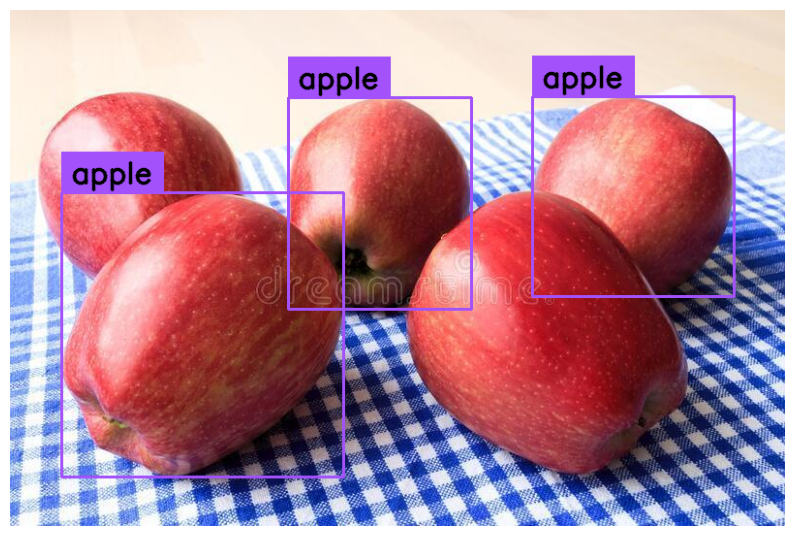

In [30]:
image = cv2.imread(SOURCE_IMAGE_PATH)
results = model_yl.infer(image, text=classes, confidence=0.001)
detections = sv.Detections.from_inference(results).with_nms(threshold=0.1)

from cv2.typing import MatLike

BOUNDING_BOX_ANNOTATOR = sv.BoundingBoxAnnotator(thickness=2)
LABEL_ANNOTATOR = sv.LabelAnnotator(text_thickness=2, text_scale=1, text_color=sv.Color.BLACK)

annotated_image: MatLike = image.copy()
annotated_image = BOUNDING_BOX_ANNOTATOR.annotate(annotated_image, detections)
annotated_image = LABEL_ANNOTATOR.annotate(annotated_image, detections)
sv.plot_image(annotated_image, (10, 10))

## Complex Scenes (Multiple Objects, Interactions)
### Objective
- Test performance with cluttered, complex scenes with multiple objects interacting

### Image
- A kitchen with a person cutting vegetables, utensils, fruits, and appliances

In [31]:
IMAGE_NAME = "kitchenscene.jpg"
IMAGE_PATH = os.path.join(HOME, "data",IMAGE_NAME)
SOURCE_IMAGE_PATH: str = IMAGE_PATH
SOURCE_IMAGE_PATH

'/teamspace/studios/this_studio/ODProject/data/kitchenscene.jpg'

In [32]:
classes = ["person", "knife", "microwave", "cutting board", "orange", "salt shaker", "bread loaf", "kale", "spinach", "laddle", "sink", "tap"]

In [33]:
import cv2
import numpy as np

image = cv2.imread(filename=SOURCE_IMAGE_PATH)
if image is None or not isinstance(image, np.ndarray):
    print("Error: Image not loaded properly.")
else:
    print(f"Image shape: {image.shape}")

Image shape: (480, 720, 3)


SupervisionWarnings: BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


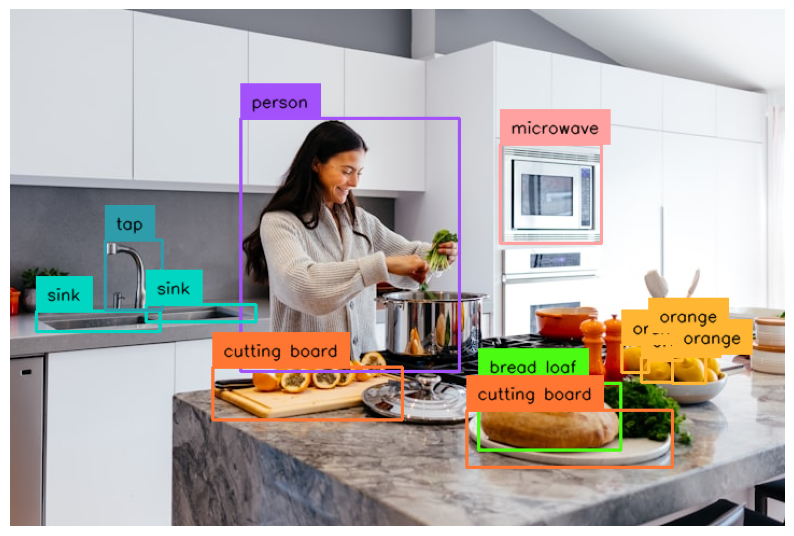

In [64]:
image = cv2.imread(SOURCE_IMAGE_PATH)
results = model_yl.infer(image, text=classes, confidence=0.3)
detections = sv.Detections.from_inference(results).with_nms(threshold=0.1)

from cv2.typing import MatLike

BOUNDING_BOX_ANNOTATOR = sv.BoundingBoxAnnotator(thickness=2)
LABEL_ANNOTATOR = sv.LabelAnnotator(text_thickness=1, text_scale=0.5, text_color=sv.Color.BLACK)

annotated_image: MatLike = image.copy()
annotated_image = BOUNDING_BOX_ANNOTATOR.annotate(annotated_image, detections)
annotated_image = LABEL_ANNOTATOR.annotate(annotated_image, detections)
sv.plot_image(annotated_image, (10, 10))

## Small Object Detection
### Objective
- Testing the ability to locate small or hidden objects in a larger image

In [65]:
IMAGE_NAME = "coins.jpg"
IMAGE_PATH = os.path.join(HOME, "data",IMAGE_NAME)
SOURCE_IMAGE_PATH: str = IMAGE_PATH
SOURCE_IMAGE_PATH

'/teamspace/studios/this_studio/ODProject/data/coins.jpg'

In [66]:
classes = ["orange penny"]

SupervisionWarnings: BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


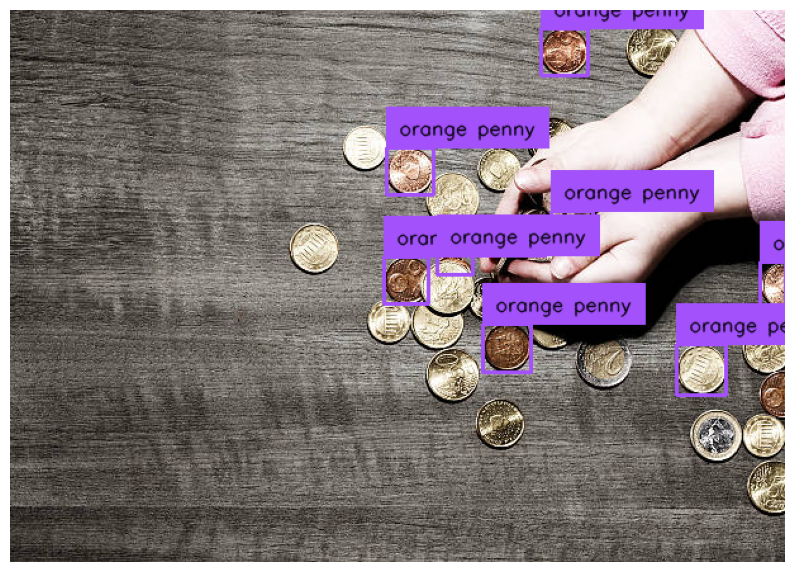

In [82]:
image = cv2.imread(SOURCE_IMAGE_PATH)
results = model_yl.infer(image, text=classes, confidence=0.024)
detections = sv.Detections.from_inference(results).with_nms(threshold=0.1)

from cv2.typing import MatLike

BOUNDING_BOX_ANNOTATOR = sv.BoundingBoxAnnotator(thickness=2)
LABEL_ANNOTATOR = sv.LabelAnnotator(text_thickness=1, text_scale=0.5, text_color=sv.Color.BLACK)

annotated_image: MatLike = image.copy()
annotated_image = BOUNDING_BOX_ANNOTATOR.annotate(annotated_image, detections)
annotated_image = LABEL_ANNOTATOR.annotate(annotated_image, detections)
sv.plot_image(annotated_image, (10, 10))

## Occlusion and Overlap
### Objective
- Assessing the effect of overlapping objects on finding objects that seem incomplete in images

In [83]:
IMAGE_NAME = "overlapkeyboard.jpg"
IMAGE_PATH = os.path.join(HOME, "data",IMAGE_NAME)
SOURCE_IMAGE_PATH: str = IMAGE_PATH
SOURCE_IMAGE_PATH

'/teamspace/studios/this_studio/ODProject/data/overlapkeyboard.jpg'

In [86]:
classes = ["keyboard"]

SupervisionWarnings: BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


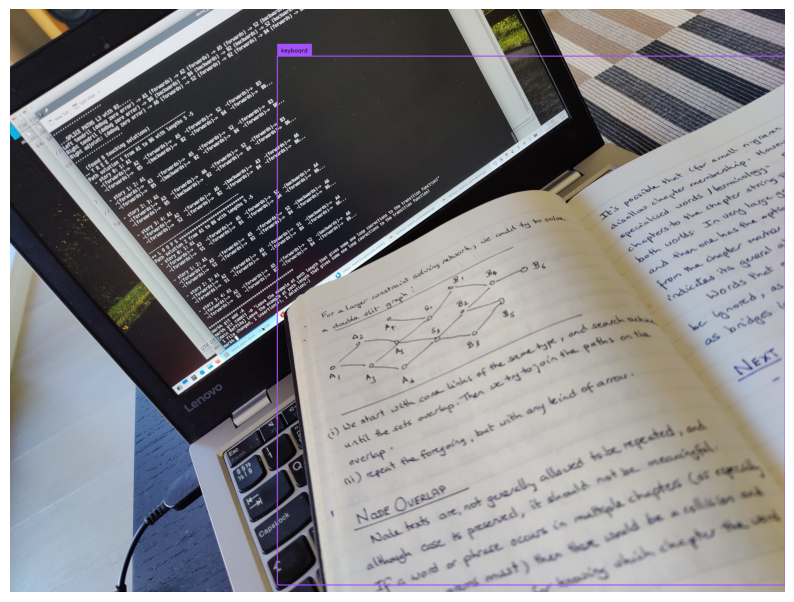

In [89]:
image = cv2.imread(SOURCE_IMAGE_PATH)
results = model_yl.infer(image, text=classes, confidence=0.02)
detections = sv.Detections.from_inference(results).with_nms(threshold=0.1)

from cv2.typing import MatLike

BOUNDING_BOX_ANNOTATOR = sv.BoundingBoxAnnotator(thickness=2)
LABEL_ANNOTATOR = sv.LabelAnnotator(text_thickness=1, text_scale=0.5, text_color=sv.Color.BLACK)

annotated_image: MatLike = image.copy()
annotated_image = BOUNDING_BOX_ANNOTATOR.annotate(annotated_image, detections)
annotated_image = LABEL_ANNOTATOR.annotate(annotated_image, detections)
sv.plot_image(annotated_image, (10, 10))

## Contextual Understanding
### Objective
- Identifying context behind images

In [90]:
IMAGE_NAME = "protectedfromrain.jpg"
IMAGE_PATH = os.path.join(HOME, "data",IMAGE_NAME)
SOURCE_IMAGE_PATH: str = IMAGE_PATH
SOURCE_IMAGE_PATH

'/teamspace/studios/this_studio/ODProject/data/protectedfromrain.jpg'

In [91]:
classes = ["protected from rain"]

SupervisionWarnings: BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


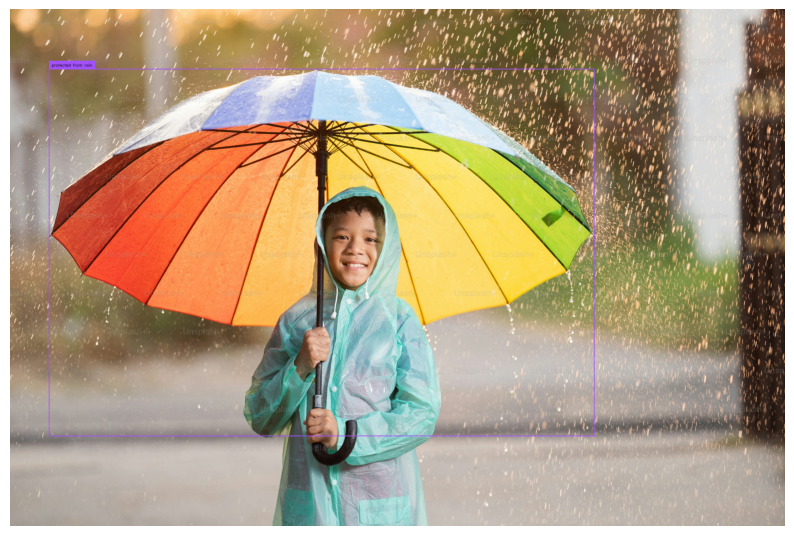

In [95]:
image = cv2.imread(SOURCE_IMAGE_PATH)
results = model_yl.infer(image, text=classes, confidence=0.1)
detections = sv.Detections.from_inference(results).with_nms(threshold=0.1)

from cv2.typing import MatLike

BOUNDING_BOX_ANNOTATOR = sv.BoundingBoxAnnotator(thickness=2)
LABEL_ANNOTATOR = sv.LabelAnnotator(text_thickness=1, text_scale=0.5, text_color=sv.Color.BLACK)

annotated_image: MatLike = image.copy()
annotated_image = BOUNDING_BOX_ANNOTATOR.annotate(annotated_image, detections)
annotated_image = LABEL_ANNOTATOR.annotate(annotated_image, detections)
sv.plot_image(annotated_image, (10, 10))

## Scene and Environment Detection
### Objective
- Identifying environmental features in the background

In [97]:
IMAGE_NAME = "beachandmountain.webp"
IMAGE_PATH = os.path.join(HOME, "data",IMAGE_NAME)
SOURCE_IMAGE_PATH: str = IMAGE_PATH
SOURCE_IMAGE_PATH

'/teamspace/studios/this_studio/ODProject/data/beachandmountain.webp'

In [98]:
classes = ["beach","mountain"]

SupervisionWarnings: BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


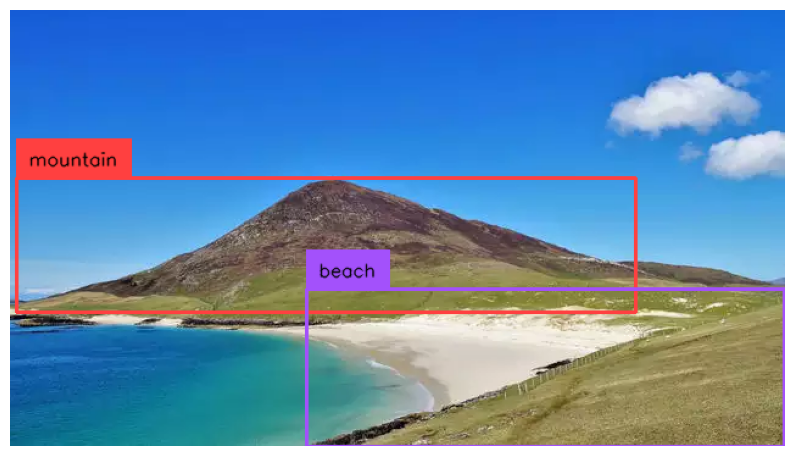

In [103]:
image = cv2.imread(SOURCE_IMAGE_PATH)
results = model_yl.infer(image, text=classes, confidence=0.001)
detections = sv.Detections.from_inference(results).with_nms(threshold=0.1)

from cv2.typing import MatLike

BOUNDING_BOX_ANNOTATOR = sv.BoundingBoxAnnotator(thickness=2)
LABEL_ANNOTATOR = sv.LabelAnnotator(text_thickness=1, text_scale=0.5, text_color=sv.Color.BLACK)

annotated_image: MatLike = image.copy()
annotated_image = BOUNDING_BOX_ANNOTATOR.annotate(annotated_image, detections)
annotated_image = LABEL_ANNOTATOR.annotate(annotated_image, detections)
sv.plot_image(annotated_image, (10, 10))

## Rare Objects/Edge Cases
### Objective: 
- Detecting unusual or obscure items

In [104]:
IMAGE_NAME = "Fireball_Card.jpg"
IMAGE_PATH = os.path.join(HOME, "data",IMAGE_NAME)
SOURCE_IMAGE_PATH: str = IMAGE_PATH
SOURCE_IMAGE_PATH

'/teamspace/studios/this_studio/ODProject/data/Fireball_Card.jpg'

In [106]:
classes = ["fireball","card"]

SupervisionWarnings: BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


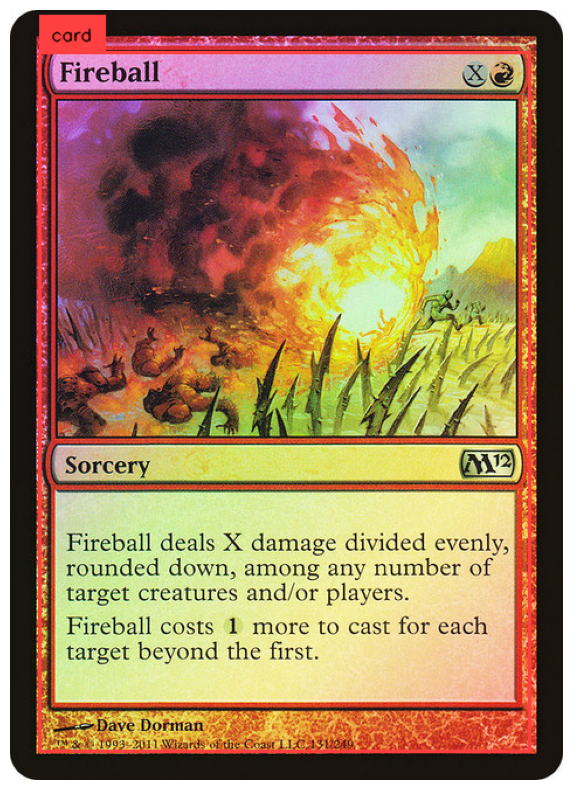

In [111]:
image = cv2.imread(SOURCE_IMAGE_PATH)
results = model_yl.infer(image, text=classes, confidence=0.0005)
detections = sv.Detections.from_inference(results).with_nms(threshold=0.1)

from cv2.typing import MatLike

BOUNDING_BOX_ANNOTATOR = sv.BoundingBoxAnnotator(thickness=2)
LABEL_ANNOTATOR = sv.LabelAnnotator(text_thickness=1, text_scale=0.5, text_color=sv.Color.BLACK)

annotated_image: MatLike = image.copy()
annotated_image = BOUNDING_BOX_ANNOTATOR.annotate(annotated_image, detections)
annotated_image = LABEL_ANNOTATOR.annotate(annotated_image, detections)
sv.plot_image(annotated_image, (10, 10))

## Text and Symbol Recognition
### Objective:
- Recognizing printed words or symbols

In [112]:
IMAGE_NAME = "greek symbols.jpg"
IMAGE_PATH = os.path.join(HOME, "data",IMAGE_NAME)
SOURCE_IMAGE_PATH: str = IMAGE_PATH
SOURCE_IMAGE_PATH

'/teamspace/studios/this_studio/ODProject/data/greek symbols.jpg'

In [113]:
classes = ["circle theta symbol"]

SupervisionWarnings: BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


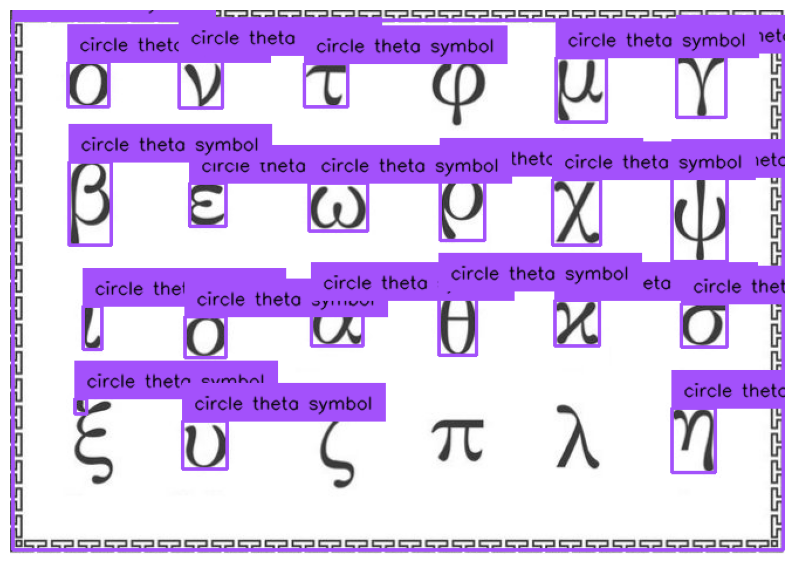

In [127]:
image = cv2.imread(SOURCE_IMAGE_PATH)
results = model_yl.infer(image, text=classes, confidence=0.000002)
detections = sv.Detections.from_inference(results).with_nms(threshold=0.1)

from cv2.typing import MatLike

BOUNDING_BOX_ANNOTATOR = sv.BoundingBoxAnnotator(thickness=2)
LABEL_ANNOTATOR = sv.LabelAnnotator(text_thickness=1, text_scale=0.5, text_color=sv.Color.BLACK)

annotated_image: MatLike = image.copy()
annotated_image = BOUNDING_BOX_ANNOTATOR.annotate(annotated_image, detections)
annotated_image = LABEL_ANNOTATOR.annotate(annotated_image, detections)
sv.plot_image(annotated_image, (10, 10))

## Adversarial/Noisy images
### Objective:
- Testing performance on blurry,noisy images

In [128]:
IMAGE_NAME = "blurry.webp"
IMAGE_PATH = os.path.join(HOME, "data",IMAGE_NAME)
SOURCE_IMAGE_PATH: str = IMAGE_PATH
SOURCE_IMAGE_PATH

'/teamspace/studios/this_studio/ODProject/data/blurry.webp'

In [129]:
classes = ["train","person"]

SupervisionWarnings: BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


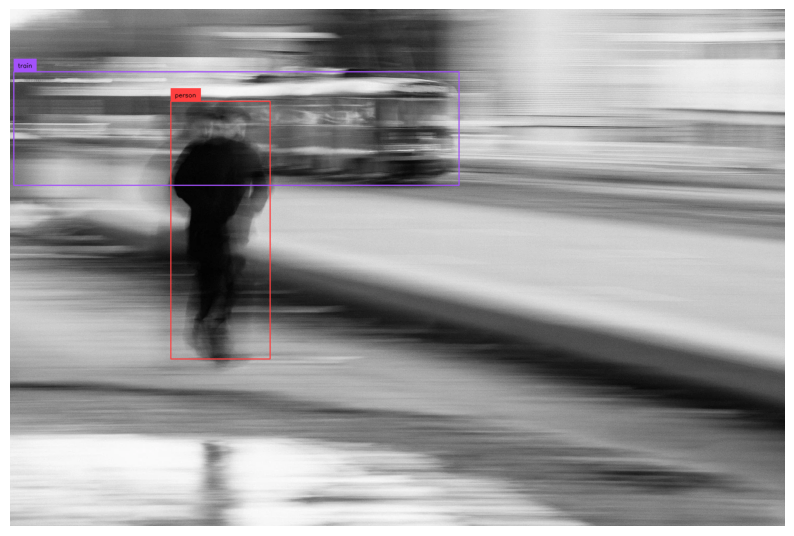

In [132]:
image = cv2.imread(SOURCE_IMAGE_PATH)
results = model_yl.infer(image, text=classes, confidence=0.03)
detections = sv.Detections.from_inference(results).with_nms(threshold=0.1)

from cv2.typing import MatLike

BOUNDING_BOX_ANNOTATOR = sv.BoundingBoxAnnotator(thickness=2)
LABEL_ANNOTATOR = sv.LabelAnnotator(text_thickness=1, text_scale=0.5, text_color=sv.Color.BLACK)

annotated_image: MatLike = image.copy()
annotated_image = BOUNDING_BOX_ANNOTATOR.annotate(annotated_image, detections)
annotated_image = LABEL_ANNOTATOR.annotate(annotated_image, detections)
sv.plot_image(annotated_image, (10, 10))

# R-CNN

## Basic Markdown
### Objective
- Easily identify basic objects in high resolution images

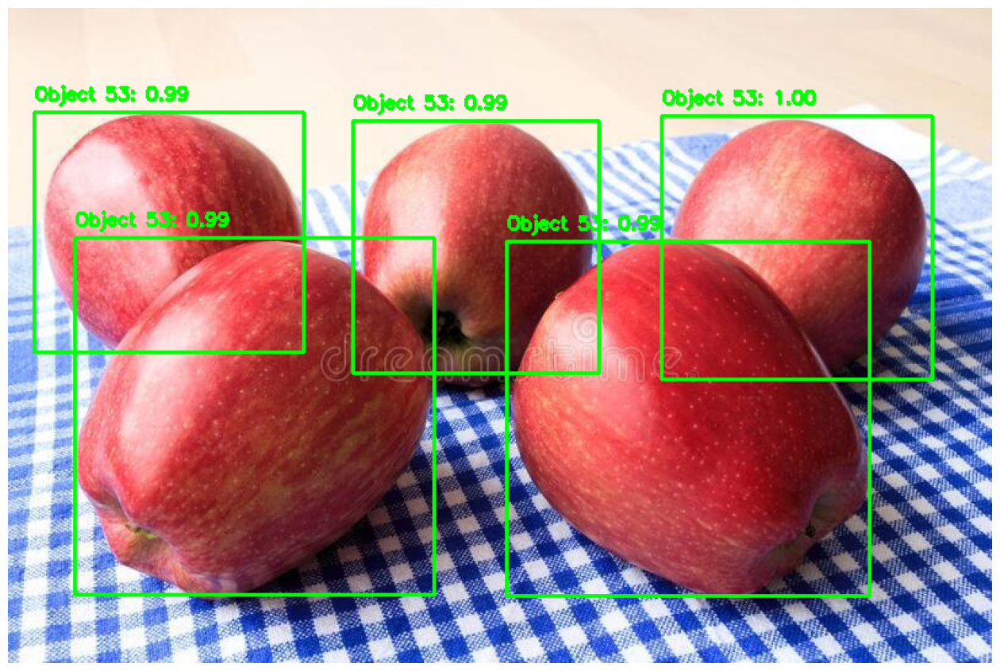

In [135]:
import torch
import torchvision.transforms as T
from torchvision.models.detection import fasterrcnn_resnet50_fpn
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Load a pre-trained Faster R-CNN model
model = fasterrcnn_resnet50_fpn(pretrained=True)
model.eval()

# Define image path
IMAGE_NAME = "00004.jpg"
IMAGE_PATH = os.path.join(HOME, "apl","JPEGImages",IMAGE_NAME)

# Load and preprocess image
image = cv2.imread(IMAGE_PATH)
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert to RGB
transform = T.Compose([T.ToTensor()])
image_tensor = transform(image_rgb).unsqueeze(0)  # Add batch dimension

# Run inference
with torch.no_grad():
    predictions = model(image_tensor)

# Extract boxes, scores, and labels
boxes = predictions[0]['boxes'].numpy()
scores = predictions[0]['scores'].numpy()
labels = predictions[0]['labels'].numpy()

# Set confidence threshold
CONFIDENCE_THRESHOLD = 0.85
filtered_indices = np.where(scores > CONFIDENCE_THRESHOLD)[0]

# Draw bounding boxes
for i in filtered_indices:
    x1, y1, x2, y2 = map(int, boxes[i])
    cv2.rectangle(image_rgb, (x1, y1), (x2, y2), (0, 255, 0), 2)
    cv2.putText(image_rgb, f"Object {labels[i]}: {scores[i]:.2f}", 
                (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)

# Display image with detections
plt.figure(figsize=(16, 16))
plt.imshow(image_rgb)
plt.axis("off")
plt.show()

## Complex Scenes (Multiple Objects, Interactions)
### Objective
- Test performance with cluttered, complex scenes with multiple objects interacting

### Image
- A kitchen with a person cutting vegetables, utensils, fruits, and appliances

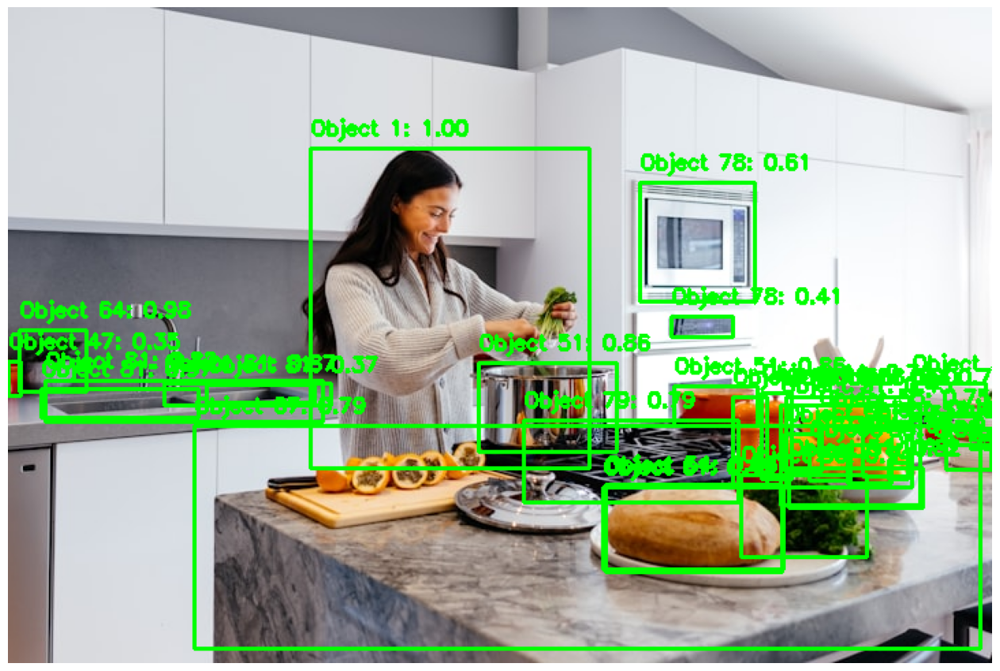

In [137]:
import torch
import torchvision.transforms as T
from torchvision.models.detection import fasterrcnn_resnet50_fpn
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Load a pre-trained Faster R-CNN model
model = fasterrcnn_resnet50_fpn(pretrained=True)
model.eval()

# Define image path
IMAGE_NAME = "kitchenscene.jpg"
IMAGE_PATH = os.path.join(HOME, "data",IMAGE_NAME)

# Load and preprocess image
image = cv2.imread(IMAGE_PATH)
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert to RGB
transform = T.Compose([T.ToTensor()])
image_tensor = transform(image_rgb).unsqueeze(0)  # Add batch dimension

# Run inference
with torch.no_grad():
    predictions = model(image_tensor)

# Extract boxes, scores, and labels
boxes = predictions[0]['boxes'].numpy()
scores = predictions[0]['scores'].numpy()
labels = predictions[0]['labels'].numpy()

# Set confidence threshold
CONFIDENCE_THRESHOLD = 0.35
filtered_indices = np.where(scores > CONFIDENCE_THRESHOLD)[0]

# Draw bounding boxes
for i in filtered_indices:
    x1, y1, x2, y2 = map(int, boxes[i])
    cv2.rectangle(image_rgb, (x1, y1), (x2, y2), (0, 255, 0), 2)
    cv2.putText(image_rgb, f"Object {labels[i]}: {scores[i]:.2f}", 
                (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)

# Display image with detections
plt.figure(figsize=(16, 16))
plt.imshow(image_rgb)
plt.axis("off")
plt.show()

## Small Object Detection
### Objective
- Testing the ability to locate small or hidden objects in a larger image

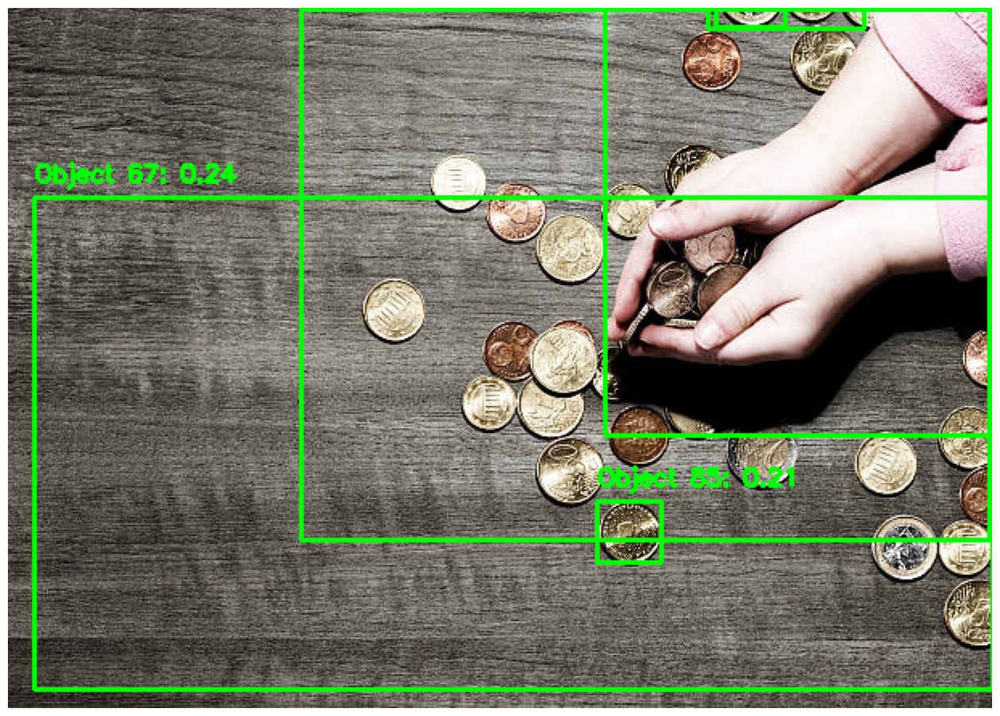

In [141]:
import torch
import torchvision.transforms as T
from torchvision.models.detection import fasterrcnn_resnet50_fpn
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Load a pre-trained Faster R-CNN model
model = fasterrcnn_resnet50_fpn(pretrained=True)
model.eval()

# Define image path
IMAGE_NAME = "coins.jpg"
IMAGE_PATH = os.path.join(HOME, "data",IMAGE_NAME)

# Load and preprocess image
image = cv2.imread(IMAGE_PATH)
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert to RGB
transform = T.Compose([T.ToTensor()])
image_tensor = transform(image_rgb).unsqueeze(0)  # Add batch dimension

# Run inference
with torch.no_grad():
    predictions = model(image_tensor)

# Extract boxes, scores, and labels
boxes = predictions[0]['boxes'].numpy()
scores = predictions[0]['scores'].numpy()
labels = predictions[0]['labels'].numpy()

# Set confidence threshold
CONFIDENCE_THRESHOLD = 0.15
filtered_indices = np.where(scores > CONFIDENCE_THRESHOLD)[0]

# Draw bounding boxes
for i in filtered_indices:
    x1, y1, x2, y2 = map(int, boxes[i])
    cv2.rectangle(image_rgb, (x1, y1), (x2, y2), (0, 255, 0), 2)
    cv2.putText(image_rgb, f"Object {labels[i]}: {scores[i]:.2f}", 
                (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)

# Display image with detections
plt.figure(figsize=(16, 16))
plt.imshow(image_rgb)
plt.axis("off")
plt.show()

## Occlusion and Overlap
### Objective
- Assessing the effect of overlapping objects on finding objects that seem incomplete in images

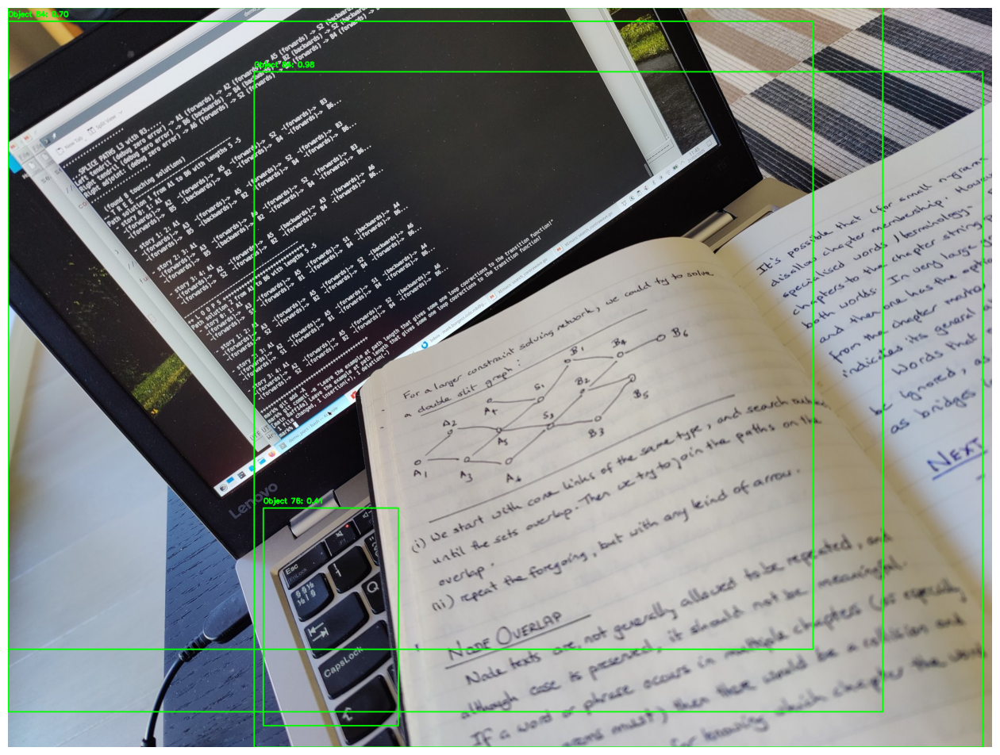

In [144]:
import torch
import torchvision.transforms as T
from torchvision.models.detection import fasterrcnn_resnet50_fpn
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Load a pre-trained Faster R-CNN model
model = fasterrcnn_resnet50_fpn(pretrained=True)
model.eval()

# Define image path
IMAGE_NAME = "overlapkeyboard.jpg"
IMAGE_PATH = os.path.join(HOME, "data",IMAGE_NAME)

# Load and preprocess image
image = cv2.imread(IMAGE_PATH)
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert to RGB
transform = T.Compose([T.ToTensor()])
image_tensor = transform(image_rgb).unsqueeze(0)  # Add batch dimension

# Run inference
with torch.no_grad():
    predictions = model(image_tensor)

# Extract boxes, scores, and labels
boxes = predictions[0]['boxes'].numpy()
scores = predictions[0]['scores'].numpy()
labels = predictions[0]['labels'].numpy()

# Set confidence threshold
CONFIDENCE_THRESHOLD = 0.4
filtered_indices = np.where(scores > CONFIDENCE_THRESHOLD)[0]

# Draw bounding boxes
for i in filtered_indices:
    x1, y1, x2, y2 = map(int, boxes[i])
    cv2.rectangle(image_rgb, (x1, y1), (x2, y2), (0, 255, 0), 2)
    cv2.putText(image_rgb, f"Object {labels[i]}: {scores[i]:.2f}", 
                (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)

# Display image with detections
plt.figure(figsize=(16, 16))
plt.imshow(image_rgb)
plt.axis("off")
plt.show()

## Contextual Understanding
### Objective
- Identifying context behind images

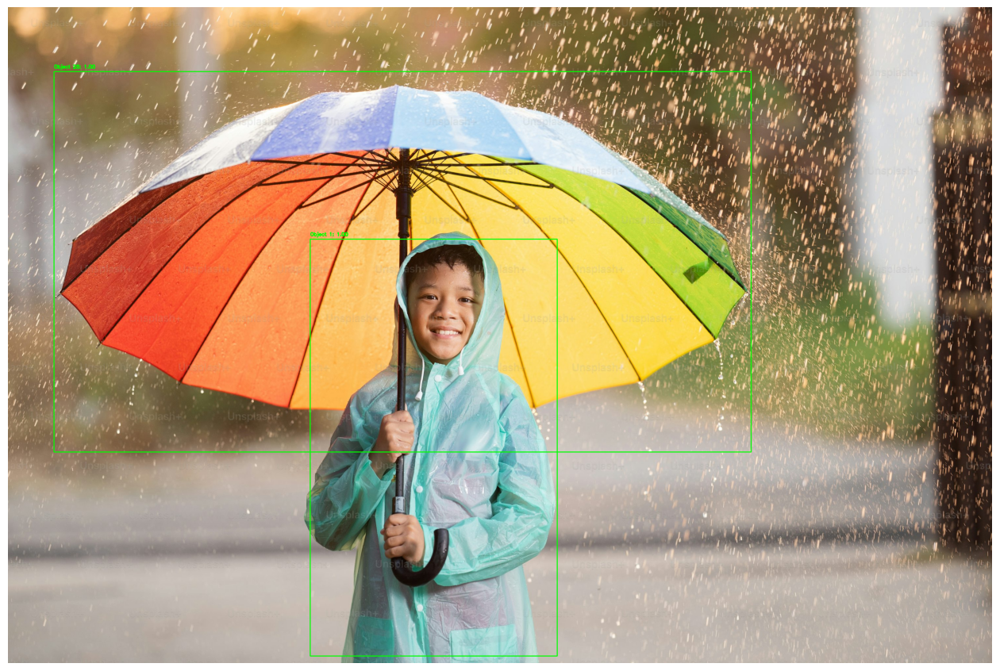

In [145]:
import torch
import torchvision.transforms as T
from torchvision.models.detection import fasterrcnn_resnet50_fpn
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Load a pre-trained Faster R-CNN model
model = fasterrcnn_resnet50_fpn(pretrained=True)
model.eval()

# Define image path
IMAGE_NAME = "protectedfromrain.jpg"
IMAGE_PATH = os.path.join(HOME, "data",IMAGE_NAME)

# Load and preprocess image
image = cv2.imread(IMAGE_PATH)
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert to RGB
transform = T.Compose([T.ToTensor()])
image_tensor = transform(image_rgb).unsqueeze(0)  # Add batch dimension

# Run inference
with torch.no_grad():
    predictions = model(image_tensor)

# Extract boxes, scores, and labels
boxes = predictions[0]['boxes'].numpy()
scores = predictions[0]['scores'].numpy()
labels = predictions[0]['labels'].numpy()

# Set confidence threshold
CONFIDENCE_THRESHOLD = 0.4
filtered_indices = np.where(scores > CONFIDENCE_THRESHOLD)[0]

# Draw bounding boxes
for i in filtered_indices:
    x1, y1, x2, y2 = map(int, boxes[i])
    cv2.rectangle(image_rgb, (x1, y1), (x2, y2), (0, 255, 0), 2)
    cv2.putText(image_rgb, f"Object {labels[i]}: {scores[i]:.2f}", 
                (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)

# Display image with detections
plt.figure(figsize=(16, 16))
plt.imshow(image_rgb)
plt.axis("off")
plt.show()

## Scene and Environment Detection
### Objective
- Identifying environmental features in the background

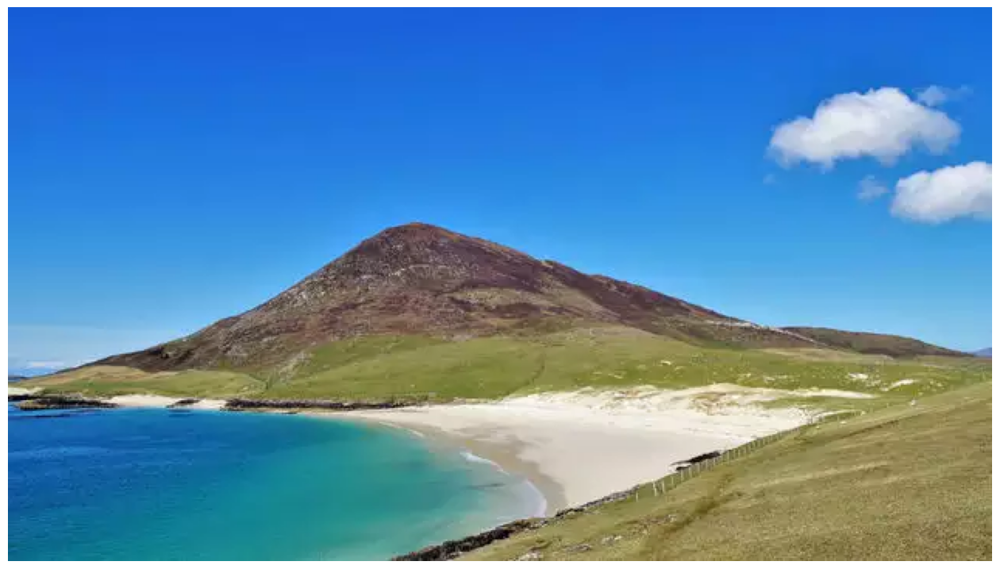

In [148]:
import torch
import torchvision.transforms as T
from torchvision.models.detection import fasterrcnn_resnet50_fpn
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Load a pre-trained Faster R-CNN model
model = fasterrcnn_resnet50_fpn(pretrained=True)
model.eval()

# Define image path
IMAGE_NAME = "beachandmountain.webp"
IMAGE_PATH = os.path.join(HOME, "data",IMAGE_NAME)

# Load and preprocess image
image = cv2.imread(IMAGE_PATH)
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert to RGB
transform = T.Compose([T.ToTensor()])
image_tensor = transform(image_rgb).unsqueeze(0)  # Add batch dimension

# Run inference
with torch.no_grad():
    predictions = model(image_tensor)

# Extract boxes, scores, and labels
boxes = predictions[0]['boxes'].numpy()
scores = predictions[0]['scores'].numpy()
labels = predictions[0]['labels'].numpy()

# Set confidence threshold
CONFIDENCE_THRESHOLD = 0.2
filtered_indices = np.where(scores > CONFIDENCE_THRESHOLD)[0]

# Draw bounding boxes
for i in filtered_indices:
    x1, y1, x2, y2 = map(int, boxes[i])
    cv2.rectangle(image_rgb, (x1, y1), (x2, y2), (0, 255, 0), 2)
    cv2.putText(image_rgb, f"Object {labels[i]}: {scores[i]:.2f}", 
                (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)

# Display image with detections
plt.figure(figsize=(16, 16))
plt.imshow(image_rgb)
plt.axis("off")
plt.show()

## Rare Objects/Edge Cases
### Objective: 
- Detecting unusual or obscure items

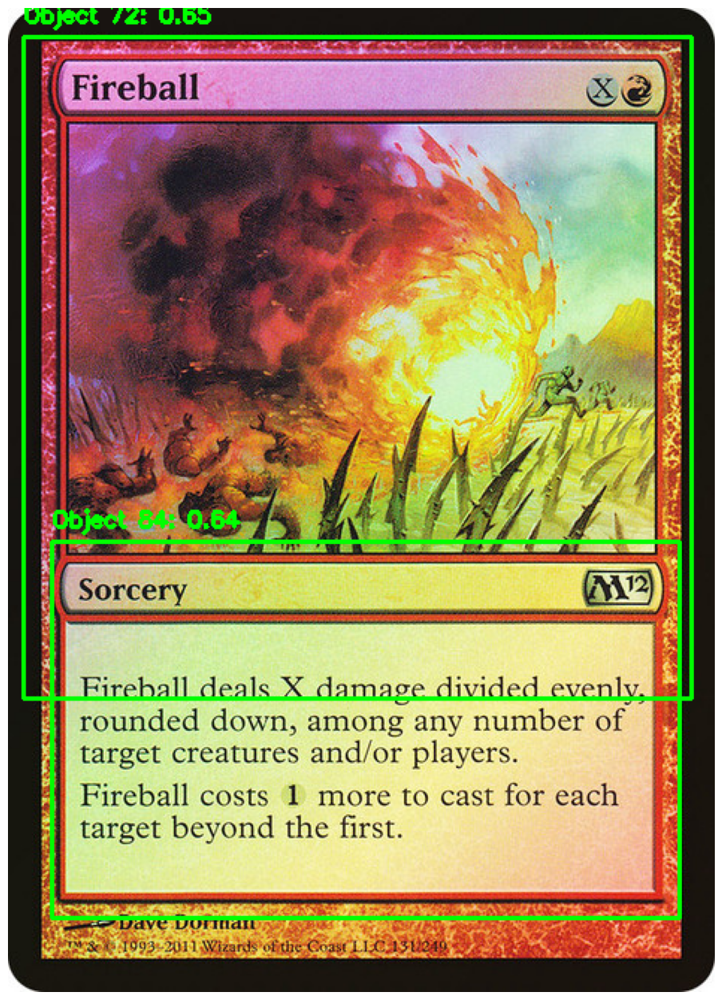

In [149]:
import torch
import torchvision.transforms as T
from torchvision.models.detection import fasterrcnn_resnet50_fpn
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Load a pre-trained Faster R-CNN model
model = fasterrcnn_resnet50_fpn(pretrained=True)
model.eval()

# Define image path
IMAGE_NAME = "Fireball_Card.jpg"
IMAGE_PATH = os.path.join(HOME, "data",IMAGE_NAME)

# Load and preprocess image
image = cv2.imread(IMAGE_PATH)
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert to RGB
transform = T.Compose([T.ToTensor()])
image_tensor = transform(image_rgb).unsqueeze(0)  # Add batch dimension

# Run inference
with torch.no_grad():
    predictions = model(image_tensor)

# Extract boxes, scores, and labels
boxes = predictions[0]['boxes'].numpy()
scores = predictions[0]['scores'].numpy()
labels = predictions[0]['labels'].numpy()

# Set confidence threshold
CONFIDENCE_THRESHOLD = 0.4
filtered_indices = np.where(scores > CONFIDENCE_THRESHOLD)[0]

# Draw bounding boxes
for i in filtered_indices:
    x1, y1, x2, y2 = map(int, boxes[i])
    cv2.rectangle(image_rgb, (x1, y1), (x2, y2), (0, 255, 0), 2)
    cv2.putText(image_rgb, f"Object {labels[i]}: {scores[i]:.2f}", 
                (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)

# Display image with detections
plt.figure(figsize=(16, 16))
plt.imshow(image_rgb)
plt.axis("off")
plt.show()

## Text and Symbol Recognition
### Objective:
- Recognizing printed words or symbols

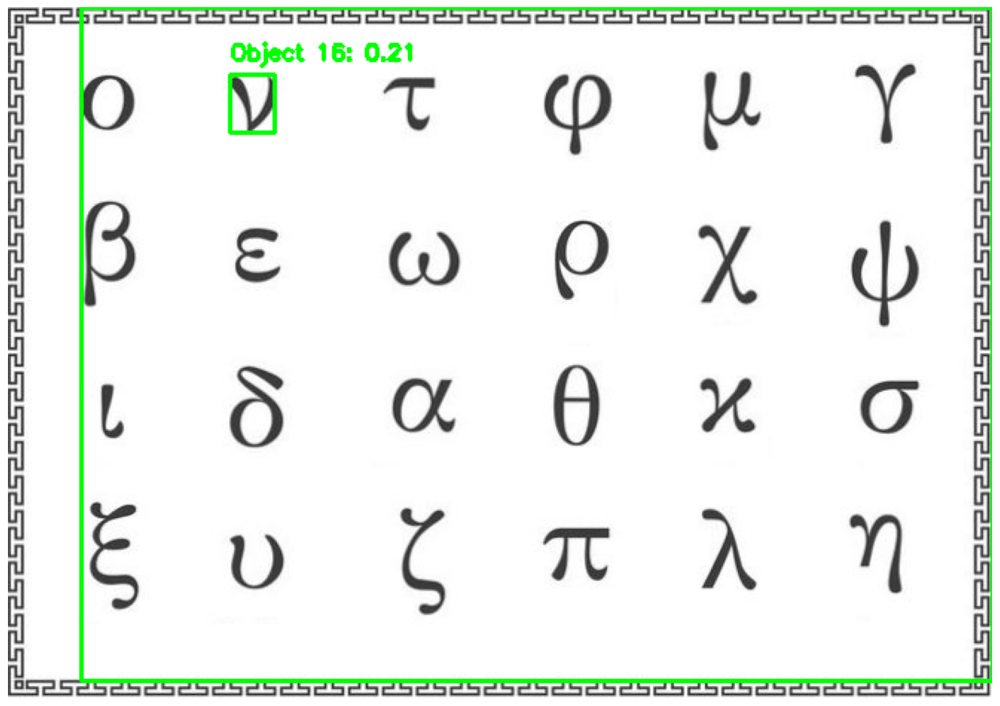

In [151]:
import torch
import torchvision.transforms as T
from torchvision.models.detection import fasterrcnn_resnet50_fpn
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Load a pre-trained Faster R-CNN model
model = fasterrcnn_resnet50_fpn(pretrained=True)
model.eval()

# Define image path
IMAGE_NAME = "greek symbols.jpg"
IMAGE_PATH = os.path.join(HOME, "data",IMAGE_NAME)

# Load and preprocess image
image = cv2.imread(IMAGE_PATH)
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert to RGB
transform = T.Compose([T.ToTensor()])
image_tensor = transform(image_rgb).unsqueeze(0)  # Add batch dimension

# Run inference
with torch.no_grad():
    predictions = model(image_tensor)

# Extract boxes, scores, and labels
boxes = predictions[0]['boxes'].numpy()
scores = predictions[0]['scores'].numpy()
labels = predictions[0]['labels'].numpy()

# Set confidence threshold
CONFIDENCE_THRESHOLD = 0.2
filtered_indices = np.where(scores > CONFIDENCE_THRESHOLD)[0]

# Draw bounding boxes
for i in filtered_indices:
    x1, y1, x2, y2 = map(int, boxes[i])
    cv2.rectangle(image_rgb, (x1, y1), (x2, y2), (0, 255, 0), 2)
    cv2.putText(image_rgb, f"Object {labels[i]}: {scores[i]:.2f}", 
                (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)

# Display image with detections
plt.figure(figsize=(16, 16))
plt.imshow(image_rgb)
plt.axis("off")
plt.show()

## Adversarial/Noisy images
### Objective:
- Testing performance on blurry,noisy images

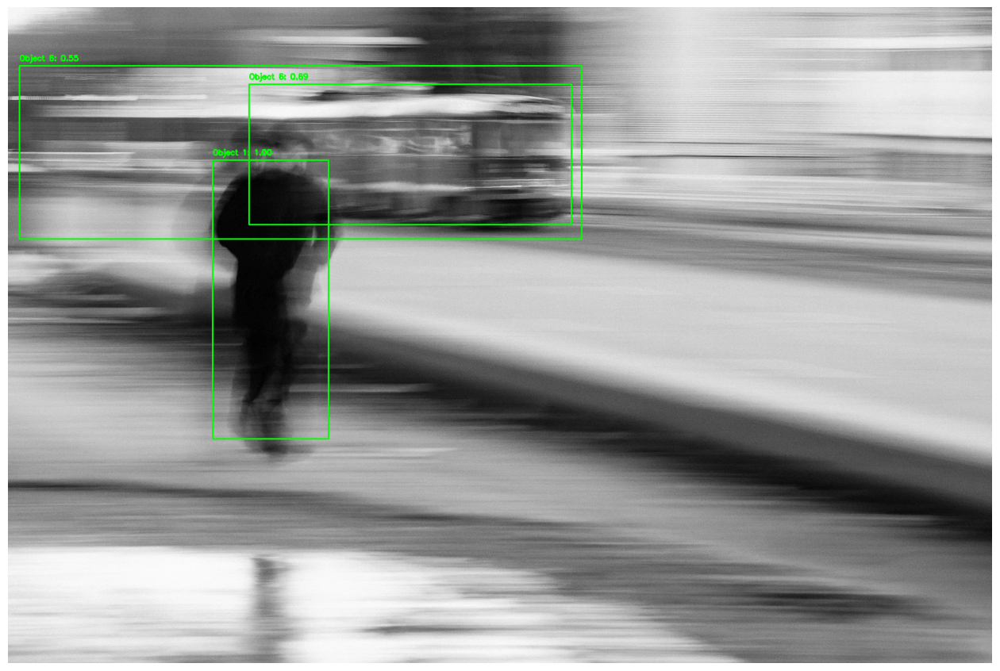

In [152]:
import torch
import torchvision.transforms as T
from torchvision.models.detection import fasterrcnn_resnet50_fpn
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Load a pre-trained Faster R-CNN model
model = fasterrcnn_resnet50_fpn(pretrained=True)
model.eval()

# Define image path
IMAGE_NAME = "blurry.webp"
IMAGE_PATH = os.path.join(HOME, "data",IMAGE_NAME)

# Load and preprocess image
image = cv2.imread(IMAGE_PATH)
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert to RGB
transform = T.Compose([T.ToTensor()])
image_tensor = transform(image_rgb).unsqueeze(0)  # Add batch dimension

# Run inference
with torch.no_grad():
    predictions = model(image_tensor)

# Extract boxes, scores, and labels
boxes = predictions[0]['boxes'].numpy()
scores = predictions[0]['scores'].numpy()
labels = predictions[0]['labels'].numpy()

# Set confidence threshold
CONFIDENCE_THRESHOLD = 0.4
filtered_indices = np.where(scores > CONFIDENCE_THRESHOLD)[0]

# Draw bounding boxes
for i in filtered_indices:
    x1, y1, x2, y2 = map(int, boxes[i])
    cv2.rectangle(image_rgb, (x1, y1), (x2, y2), (0, 255, 0), 2)
    cv2.putText(image_rgb, f"Object {labels[i]}: {scores[i]:.2f}", 
                (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)

# Display image with detections
plt.figure(figsize=(16, 16))
plt.imshow(image_rgb)
plt.axis("off")
plt.show()